# Load environment

In [1]:
import warnings

warnings.filterwarnings("ignore")

import matplotlib.pyplot as plt
import seaborn as sns
import scanpy as sc
import pandas as pd
import numpy as np
import random
import itertools

from tqdm import tqdm

import decoupler as dc
import sys

sys.path.append("./../../../../utilities_folder")
from utilities import load_object, intTable, plotGenesInTerm, getAnnGenes, run_ora_catchErrors

Set R environment with rpy2:

In [2]:
import rpy2.rinterface_lib.callbacks
import anndata2ri
import logging

from rpy2.robjects import pandas2ri
import rpy2.robjects as ro

sc.settings.verbosity = 0
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

pandas2ri.activate()
anndata2ri.activate()

%load_ext rpy2.ipython

Set up of graphical parameters for Python plots:

In [3]:
%matplotlib inline
sc.set_figure_params(dpi = 600, fontsize = 20)

plt.rcParams['pdf.fonttype'] = 'truetype'

cmap_up = sns.light_palette("red", as_cmap=True)
cmap_down = sns.light_palette("blue", as_cmap=True)
cmap_all = sns.light_palette("seagreen", as_cmap=True)

Set up of graphical parameters for R plots:

In [4]:
default_units = 'in' 
default_res = 300
default_width = 10
default_height = 9

import rpy2
old_setup_graphics = rpy2.ipython.rmagic.RMagics.setup_graphics

def new_setup_graphics(self, args):
    if getattr(args, 'units') is not None:
        if args.units != default_units:
            return old_setup_graphics(self, args)
    args.units = default_units
    if getattr(args, 'res') is None:
        args.res = default_res
    if getattr(args, 'width') is None:
        args.width = default_width
    if getattr(args, 'height') is None:
        args.height = default_height        
    return old_setup_graphics(self, args)


rpy2.ipython.rmagic.RMagics.setup_graphics = new_setup_graphics

Here the cell were we inject the parameters using Quarto renderer:

In [5]:
#| tags: [parameters]
# Injected Parameters
N = 3

In [6]:
#| tags: [parameters]
# Injected Parameters
N = 3


Import R libraries:

In [7]:
%%R
source('./../../../../utilities_folder/GO_helper.r')
loc <- './../../../../R_loc' # pointing to the renv environment

.libPaths(loc)

library('topGO')
library('org.Hs.eg.db')
library(dplyr)
library(ggplot2)

Set output folders:

In [8]:
output_folder = './'
folder = './deg_in_cluster_tables/cluster_' + str(N) + '/'

import os

if not os.path.isdir(folder):
    os.makedirs(folder)

# Load data
Here we load the anndata:

In [10]:
adata = sc.read("1_All_Annotated_Triku.h5ad")
adata

AnnData object with n_obs × n_vars = 27925 × 14582
    obs: 'sample_id', 'run_id', 'probe_barcode_ids', 'subject', 'line', 'specimen', 'stage', 'condition', 'notes', 'seqRun', 'original_name', 'project', 'who', 'SC_derivation', 'micoplasma', 'mosaic', 'genSite', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'gene_UMI_ratio', 'log1p_gene_UMI_ratio', 'scDblFinder_score', 'scDblFinder_class', 'n_counts', 'n_genes', 'leiden', 'score_pluripotency', 'score_mesoderm', 'score_PS', 'score_EM', 'score_AM', 'score_Endo', 'score_Epi', 'score_HEP', 'score_NM', 'score_ExM', 'score_Ery', 'score_EAE', 'score_Amnion_LC', 'score_AxM', 'score_Amnion', 'score_NNE', 'score_PGC', 'score_hPGCLCs', 'score_DE1', 'score_DE2', 'score_Hypoblast', 'score_YS', 'score_EMPs', 'score_Endothelium', 'score_Myeloid_Progenitors', 'score_Megakaryocyte_

Here we load the dictionary that associates to each GO term its genes:

In [9]:
GO2gene = load_object('./../../../../data/GO2gene_complete.pickle')

# Markers of cluster

We filter genes for the cluster under investigation based on the p-value adjusted that we then convert in -log(p-value adjusted):

In [11]:
markers = sc.get.rank_genes_groups_df(adata, group=str(N))
intTable(markers, folder=folder, fileName = 'markers_cluster_before_filtering_' + str(N) + '.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./deg_in_cluster_tables/c..., filename='markers_cluster_before_fi..., label='Download markers_cluster_...)
    [1] Tabulator(page_size=10, pagination='remote', value=          names  ...)

In [12]:
markers = markers.set_index('names')
markers = markers[markers.pvals_adj < 0.01]
markers['FDR'] = markers['pvals_adj']
markers['-log10(FDR)'] = -np.log10(markers.pvals_adj)
markers = markers.replace(np.inf, markers[markers['-log10(FDR)'] != np.inf]['-log10(FDR)'].max())
markers

,scores,logfoldchanges,pvals,pvals_adj,pct_nz_group,pct_nz_reference,FDR,-log10(FDR)
names,,,,,,,,
CDKN1A,76.658607,4.719763,0.0,0.0,0.935525,0.151674,0.0,307.381051
PMAIP1,66.903725,2.798164,0.0,0.0,0.998388,0.678000,0.0,307.381051
BBC3,66.049202,2.870219,0.0,0.0,0.913282,0.444024,0.0,307.381051
MDM2,59.869816,1.719842,0.0,0.0,0.982914,0.874270,0.0,307.381051
GDF15,57.281502,4.829359,0.0,0.0,0.680529,0.076542,0.0,307.381051
...,...,...,...,...,...,...,...,...
COL18A1,-38.964970,-0.885744,0.0,0.0,0.974533,0.981630,0.0,307.381051
SERPINB9,-39.080200,-2.335923,0.0,0.0,0.536428,0.761834,0.0,307.381051
RHOB,-39.706852,-2.158470,0.0,0.0,0.476467,0.731741,0.0,307.381051


In [13]:
intTable(markers, folder=folder, fileName = 'markers_cluster_filtered_' + str(N) + '.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./deg_in_cluster_tables/c..., filename='markers_cluster_filtered_..., label='Download markers_cluster_...)
    [1] Tabulator(page_size=10, pagination='remote', value=             s...)

## Select up and downregulated markers
### Up

In [14]:
pos = markers[markers.logfoldchanges > 1]
pos

,scores,logfoldchanges,pvals,pvals_adj,pct_nz_group,pct_nz_reference,FDR,-log10(FDR)
names,,,,,,,,
CDKN1A,76.658607,4.719763,0.000000,0.000000,0.935525,0.151674,0.000000,307.381051
PMAIP1,66.903725,2.798164,0.000000,0.000000,0.998388,0.678000,0.000000,307.381051
BBC3,66.049202,2.870219,0.000000,0.000000,0.913282,0.444024,0.000000,307.381051
MDM2,59.869816,1.719842,0.000000,0.000000,0.982914,0.874270,0.000000,307.381051
GDF15,57.281502,4.829359,0.000000,0.000000,0.680529,0.076542,0.000000,307.381051
...,...,...,...,...,...,...,...,...
SV2B,2.772086,1.305372,0.005570,0.008741,0.053191,0.022842,0.008741,2.058450
MAATS1,2.769232,1.138112,0.005619,0.008813,0.058672,0.028401,0.008813,2.054878
FCN3,2.765323,1.241999,0.005687,0.008908,0.051257,0.020908,0.008908,2.050229


In [15]:
pos['-log10(FDR)'] = -np.log10(pos.pvals_adj)
#pos = pos.fillna('inf')
pos = pos.replace(np.inf, pos[pos['-log10(FDR)'] != np.inf]['-log10(FDR)'].max())
pos['FDR'] = pos['pvals_adj']
up_regGenes = pos.index.tolist()
allUpSelected = adata.var_names.isin(up_regGenes).astype('int').tolist()

### Down

In [16]:
neg = markers[markers.logfoldchanges < -1].sort_values(by = 'logfoldchanges')
neg

,scores,logfoldchanges,pvals,pvals_adj,pct_nz_group,pct_nz_reference,FDR,-log10(FDR)
names,,,,,,,,
PRRX1,-21.086056,-29.444427,1.068039e-98,1.470647e-97,0.000000,0.231841,1.470647e-97,96.832492
HOXA13,-16.136053,-28.769524,1.423569e-58,1.095434e-57,0.000000,0.177416,1.095434e-57,56.960414
HOXB3,-17.740866,-28.757044,2.027865e-70,1.887067e-69,0.000000,0.195061,1.887067e-69,68.724213
HOXB4,-14.417660,-28.407099,4.007026e-47,2.510978e-46,0.000000,0.158522,2.510978e-46,45.600157
HOXB6,-13.923025,-28.310961,4.590527e-44,2.716683e-43,0.000000,0.153084,2.716683e-43,42.565961
...,...,...,...,...,...,...,...,...
TDRD7,-5.884551,-1.006015,3.991355e-09,9.174328e-09,0.079304,0.143496,9.174328e-09,8.037426
FSTL3,-8.260860,-1.005804,1.446260e-16,4.396366e-16,0.114120,0.204689,4.396366e-16,15.356906
BORCS7,-11.513509,-1.003570,1.127933e-30,5.023679e-30,0.167956,0.291464,5.023679e-30,29.298978


In [17]:
neg['-log10(FDR)'] = -np.log10(neg.pvals_adj)
#neg = neg.fillna('inf')
neg = neg.replace(np.inf, neg[neg['-log10(FDR)'] != np.inf]['-log10(FDR)'].max())
neg['FDR'] = neg['pvals_adj']
down_regGenes = neg.index.tolist()
allDownSelected = adata.var_names.isin(down_regGenes).astype('int').tolist()

### All regulated

In [18]:
all_sign = up_regGenes + down_regGenes
allSelected = adata.var_names.isin(all_sign).astype('int').tolist()
allGenes = adata.var_names.tolist()

# topGO

## Upregulated

In [19]:
%%R -i allUpSelected -i allGenes

allGenes_v <- c(allUpSelected)
#print(allGenes_v)
names(allGenes_v) <- allGenes
allGenes_v <- unlist(allGenes_v)

geneNames <- c(allGenes)

ann_org_BP <- topGO::annFUN.org(whichOnto='BP', feasibleGenes=names(allGenes_v), 
                           mapping='org.Hs.eg', ID='symbol')

ann_org_MF <- topGO::annFUN.org(whichOnto='MF', feasibleGenes=names(allGenes_v), 
                           mapping='org.Hs.eg', ID='symbol')

ann_org_CC <- topGO::annFUN.org(whichOnto='CC', feasibleGenes=names(allGenes_v), 
                           mapping='org.Hs.eg', ID='symbol')

selection <- function(allScores){return (as.logical(allScores))}

::: {.panel-tabset}

### Biological Process

Get topGO results:

In [20]:
%%R -o results

GOdata <- new("topGOdata",
  ontology="BP",
  allGenes=allGenes_v,
  annot=annFUN.GO2genes,
  GO2genes=ann_org_BP,
  geneSel = selection,
  nodeSize=10)

results <- runTest(GOdata, algorithm="weight01",statistic="fisher")

Convert results from R environment to Python:

In [21]:
scores = ro.r.score(results)
score_names = ro.r(
'''
names(results@score)
'''
)
go_data = ro.r.GOdata

genesData = ro.r(
'''
geneData(results)
'''
)
genesData

array([13071,   507,    10,  4522], dtype=int32)

In [22]:
#num_summarize = min(100, len(score_names))
results_table = ro.r.GenTable(go_data, weight=results,
        orderBy="weight", topNodes=len(scores))

results_table_py = ro.conversion.rpy2py(results_table)

scores_py = ro.conversion.rpy2py(scores)
score_names = [i for i in score_names]

scores_df = pd.DataFrame({'Scores': scores_py, 'GO.ID': score_names})
results_table_py = results_table_py.merge(scores_df, left_on = 'GO.ID', right_on = 'GO.ID')
results_table_py

,GO.ID,Term,Annotated,Significant,Expected,weight,Scores
0,GO:0072593,reactive oxygen species metabolic proces...,173,18,6.71,1.2e-05,0.000012
1,GO:0006977,"DNA damage response, signal transduction...",16,6,0.62,1.9e-05,0.000019
2,GO:0042771,intrinsic apoptotic signaling pathway in...,41,9,1.59,0.00038,0.000382
3,GO:0071276,cellular response to cadmium ion,28,6,1.09,0.00060,0.000601
4,GO:0061687,detoxification of inorganic compound,12,4,0.47,0.00086,0.000864
...,...,...,...,...,...,...,...
6269,GO:2001212,regulation of vasculogenesis,15,0,0.58,1.00000,1.000000
6270,GO:2001214,positive regulation of vasculogenesis,11,0,0.43,1.00000,1.000000
6271,GO:2001223,negative regulation of neuron migration,10,0,0.39,1.00000,1.000000
6272,GO:2001224,positive regulation of neuron migration,17,0,0.66,1.00000,1.000000


Filter results:

In [23]:
results_table_py = results_table_py[results_table_py['Scores'] < 0.05]
results_table_py = results_table_py[results_table_py['Annotated'] < 200]
results_table_py = results_table_py[results_table_py['Annotated'] > 15]

results_table_py['-log10(pvalue)'] = - np.log10(results_table_py.Scores)
results_table_py['Significant/Annotated'] = results_table_py['Significant'] / results_table_py['Annotated']

In [24]:
intTable(results_table_py, folder = folder, fileName = 'GO_BP_up.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./deg_in_cluster_tables/c..., filename='GO_BP_up.xlsx', label='Download GO_BP_up.xlsx')
    [1] Tabulator(page_size=10, pagination='remote', value=          GO.ID           ...)

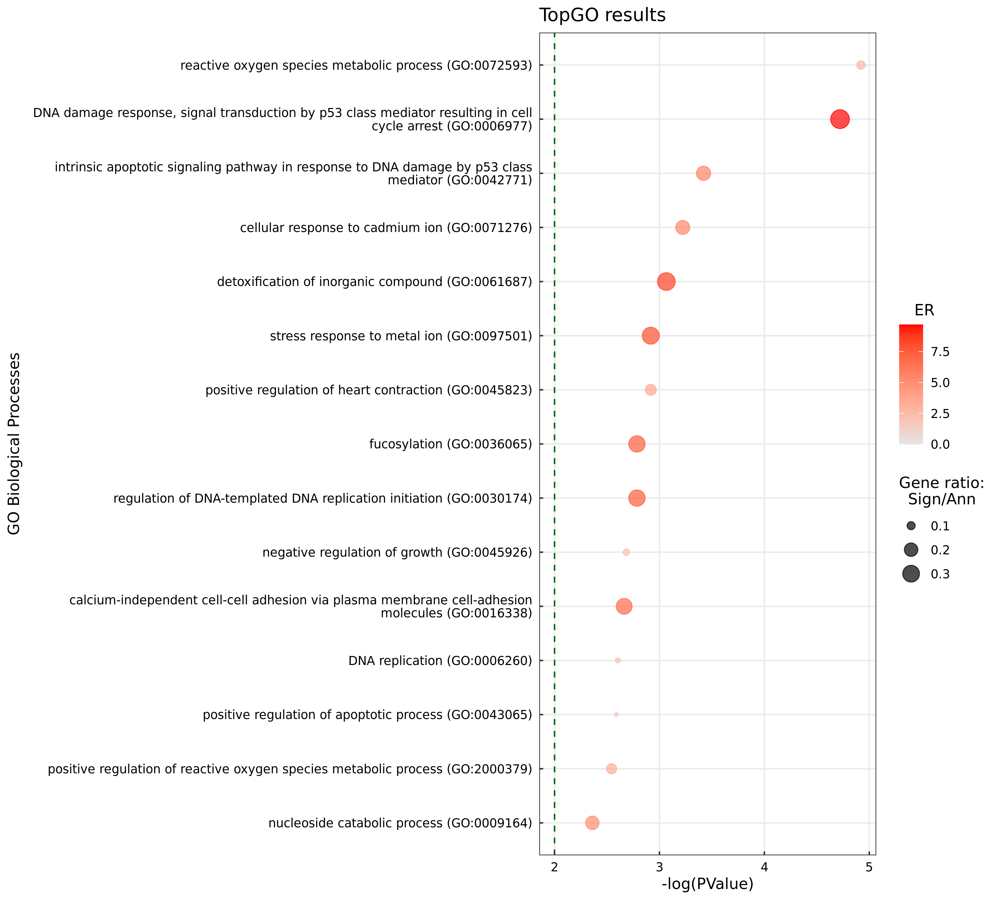

In [25]:
%%R
Res <- GenTable(GOdata, weight=results,
        orderBy="weight", topNodes=length(score(results)))
#print(Res[0:10,])
colnames(Res) <- c("GO.ID", "Term", "Annotated", "Significant", "Expected", "Statistics")
Res$ER <- Res$Significant / Res$Expected
bubbleplot(Res, Ont = 'BP', fillCol = 'red')

In [26]:
#| echo: False

# change graphic parameters to make the below plot more readable
default_width = 20
default_height = 7
rpy2.ipython.rmagic.RMagics.setup_graphics = new_setup_graphics

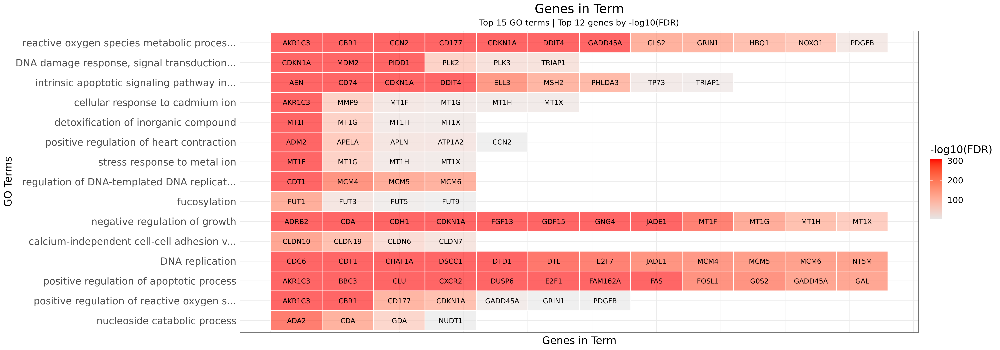

In [27]:
%%R -i markers
plotGenesInTerm_v1(Res, GOdata, SE = markers, nterms=15, ngenes=12,
                             fillCol='red', log = TRUE)

In [28]:
%%R -i markers -i folder
saveGenesInTerm(Res, GOdata, nterms = 20, path = paste0(folder,'GO_BP_genesInTerm_up.xlsx'), SE = markers)

In [29]:
#| echo: False

# change graphic parameters back
default_width = 15
default_height = 9
rpy2.ipython.rmagic.RMagics.setup_graphics = new_setup_graphics

### Molecular Function

In [30]:
%%R

GOdata <- new("topGOdata",
  ontology="MF",
  allGenes=allGenes_v,
  annot=annFUN.GO2genes,
  GO2genes=ann_org_MF,
  geneSel = selection,
  nodeSize=10)

In [31]:
%%R -o results

results <- runTest(GOdata, algorithm="weight01",statistic="fisher")

In [32]:
scores = ro.r.score(results)
score_names = ro.r(
'''
names(results@score)
'''
)
go_data = ro.r.GOdata

genesData = ro.r(
'''
geneData(results)
'''
)
genesData

array([13424,   519,    10,   776], dtype=int32)

In [33]:
#num_summarize = min(100, len(score_names))
results_table = ro.r.GenTable(go_data, weight=results,
        orderBy="weight", topNodes=len(scores))

In [34]:
results_table_py = ro.conversion.rpy2py(results_table)

In [35]:
scores_py = ro.conversion.rpy2py(scores)
score_names = [i for i in score_names]

In [36]:
scores_df = pd.DataFrame({'Scores': scores_py, 'GO.ID': score_names})
results_table_py = results_table_py.merge(scores_df, left_on = 'GO.ID', right_on = 'GO.ID')
results_table_py = results_table_py[results_table_py['Scores'] < 0.05]
results_table_py = results_table_py[results_table_py['Annotated'] < 200]
results_table_py = results_table_py[results_table_py['Annotated'] > 15]

intTable(results_table_py, folder = folder, fileName = 'GO_MF_up.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./deg_in_cluster_tables/c..., filename='GO_MF_up.xlsx', label='Download GO_MF_up.xlsx')
    [1] Tabulator(page_size=10, pagination='remote', value=         GO.ID            ...)

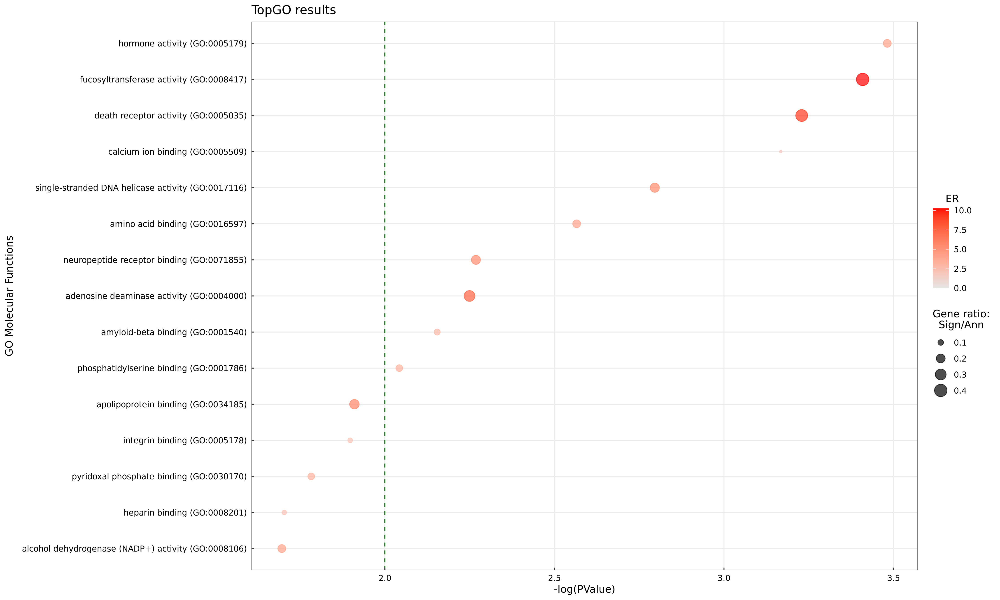

In [37]:
%%R
Res <- GenTable(GOdata, weight=results,
        orderBy="weight", topNodes=length(score(results)))
#print(Res[0:10,])
colnames(Res) <- c("GO.ID", "Term", "Annotated", "Significant", "Expected", "Statistics")
Res$ER <- Res$Significant / Res$Expected
bubbleplot(Res, Ont = 'MF', fillCol = 'red')

In [38]:
#| echo: False

default_width = 20
default_height = 7
rpy2.ipython.rmagic.RMagics.setup_graphics = new_setup_graphics

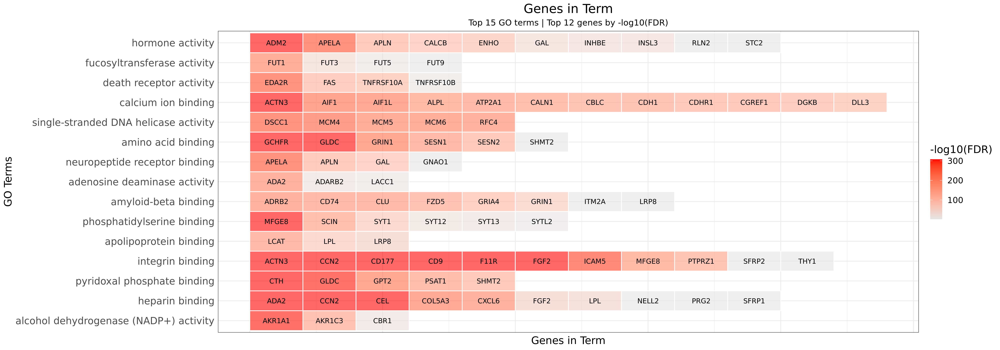

In [39]:
%%R -i markers
plotGenesInTerm_v1(Res, GOdata, SE = markers, nterms=15, ngenes=12,
                             fillCol='red', log = TRUE)

In [40]:
%%R -i markers -i folder
saveGenesInTerm(Res, GOdata, nterms = 20, path = paste0(folder,'GO_MF_genesInTerm_up.xlsx'), SE = markers)

In [41]:
#| echo: False

default_width = 15
default_height = 9
rpy2.ipython.rmagic.RMagics.setup_graphics = new_setup_graphics

### Cellular Compartment

In [42]:
%%R

GOdata <- new("topGOdata",
  ontology="CC",
  allGenes=allGenes_v,
  annot=annFUN.GO2genes,
  GO2genes=ann_org_CC,
  geneSel = selection,
  nodeSize=10)

In [43]:
%%R -o results

results <- runTest(GOdata, algorithm="weight01",statistic="fisher")

In [44]:
scores = ro.r.score(results)
score_names = ro.r(
'''
names(results@score)
'''
)
go_data = ro.r.GOdata

genesData = ro.r(
'''
geneData(results)
'''
)
genesData

array([13666,   536,    10,   547], dtype=int32)

In [45]:
#num_summarize = min(100, len(score_names))
results_table = ro.r.GenTable(go_data, weight=results,
        orderBy="weight", topNodes=len(scores))

In [46]:
results_table_py = ro.conversion.rpy2py(results_table)

In [47]:
scores_py = ro.conversion.rpy2py(scores)
score_names = [i for i in score_names]

In [48]:
scores_df = pd.DataFrame({'Scores': scores_py, 'GO.ID': score_names})
results_table_py = results_table_py.merge(scores_df, left_on = 'GO.ID', right_on = 'GO.ID')

In [49]:
results_table_py = results_table_py[results_table_py['Scores'] < 0.05]
results_table_py = results_table_py[results_table_py['Annotated'] < 200]
results_table_py = results_table_py[results_table_py['Annotated'] > 15]

intTable(results_table_py, folder = folder, fileName = 'GO_CC_up.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./deg_in_cluster_tables/c..., filename='GO_CC_up.xlsx', label='Download GO_CC_up.xlsx')
    [1] Tabulator(page_size=10, pagination='remote', value=         GO.ID  ...)

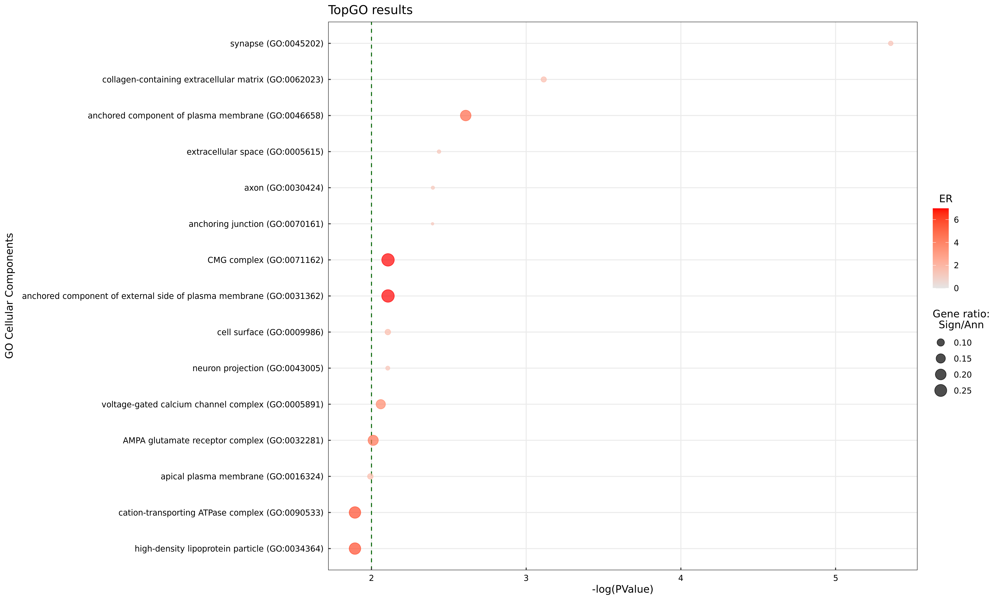

In [50]:
%%R
Res <- GenTable(GOdata, weight=results,
        orderBy="weight", topNodes=length(score(results)))
#print(Res[0:10,])
colnames(Res) <- c("GO.ID", "Term", "Annotated", "Significant", "Expected", "Statistics")
Res$ER <- Res$Significant / Res$Expected
bubbleplot(Res, Ont = 'CC', fillCol = 'red')

In [51]:
#| echo: False

default_width = 20
default_height = 7
rpy2.ipython.rmagic.RMagics.setup_graphics = new_setup_graphics

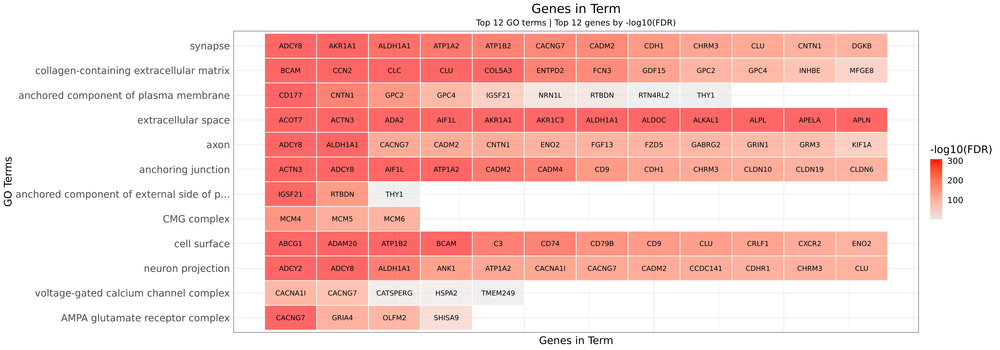

In [52]:
%%R -i markers
plotGenesInTerm_v1(Res, GOdata, SE = markers, nterms=12, ngenes=12,
                             fillCol='red', log = TRUE)

In [53]:
%%R -i markers -i folder
saveGenesInTerm(Res, GOdata, nterms = 20, path = paste0(folder,'GO_CC_genesInTerm_up.xlsx'), SE = markers)

In [54]:
#| echo: False

default_width = 15
default_height = 9
rpy2.ipython.rmagic.RMagics.setup_graphics = new_setup_graphics

### Pathway annotation

In [55]:
#| echo: False
msigdb = dc.get_resource('MSigDB')

#### Reactome

In [56]:
curated = msigdb[msigdb['collection'].isin(['reactome_pathways'])]
curated = curated[~curated.duplicated(['geneset', 'genesymbol'])]

aggregated = curated[["geneset", "genesymbol"]].groupby("geneset").count().rename(columns={"genesymbol": "gene_count"})
curated = curated[~curated.geneset.isin(aggregated[aggregated.gene_count > 200].index.tolist())].copy()
curated = curated[~curated.geneset.isin(aggregated[aggregated.gene_count < 15].index.tolist())].copy()

In [57]:
rank = pd.DataFrame(markers['-log10(FDR)'])

rank_copy = rank.copy()
rank_copy['pval'] = markers.loc[rank.index].FDR

In [58]:
rank_copy

,-log10(FDR),pval
names,,
CDKN1A,307.381051,0.0
PMAIP1,307.381051,0.0
BBC3,307.381051,0.0
MDM2,307.381051,0.0
GDF15,307.381051,0.0
...,...,...
COL18A1,307.381051,0.0
SERPINB9,307.381051,0.0
RHOB,307.381051,0.0


In [59]:
results_table_py = run_ora_catchErrors(mat=rank.T, net=curated, source='geneset', target='genesymbol', verbose=False, n_up=len(rank), n_bottom=0)
len(results_table_py)

890

In [60]:
intTable(results_table_py, folder = folder, fileName = 'Reactome_up.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./deg_in_cluster_tables/c..., filename='Reactome_up.xlsx', label='Download Reactome_up.xlsx...)
    [1] Tabulator(page_size=10, pagination='remote', value=              ...)

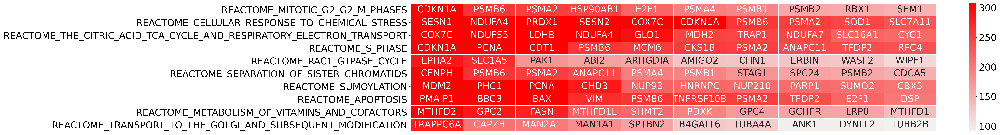

In [61]:
if len(results_table_py) > 0:
    results_table_py = getAnnGenes(results_table_py, GO2gene['reactome_pathways'], rank_copy)
    _, df = plotGenesInTerm(results = results_table_py, 
                            GO2gene = GO2gene['reactome_pathways'], DEGs = rank_copy, n_top_terms = 10, cmap = cmap_up)

In [62]:
if len(results_table_py) > 0:
    intTable(df, folder = folder, fileName = 'genesInTerm_Reactome_up.xlsx', save = True)

#### KEGG

In [63]:
curated = msigdb[msigdb['collection'].isin(['kegg_pathways'])]
curated = curated[~curated.duplicated(['geneset', 'genesymbol'])]

aggregated = curated[["geneset", "genesymbol"]].groupby("geneset").count().rename(columns={"genesymbol": "gene_count"})
curated = curated[~curated.geneset.isin(aggregated[aggregated.gene_count > 200].index.tolist())].copy()
curated = curated[~curated.geneset.isin(aggregated[aggregated.gene_count < 15].index.tolist())].copy()
results_table_py = run_ora_catchErrors(mat=rank.T, net=curated, source='geneset', target='genesymbol', verbose=False, n_up=len(rank), n_bottom=0)

In [64]:
intTable(results_table_py, folder = folder, fileName = 'KEGG_up.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./deg_in_cluster_tables/c..., filename='KEGG_up.xlsx', label='Download KEGG_up.xlsx')
    [1] Tabulator(page_size=10, pagination='remote', value=              ...)

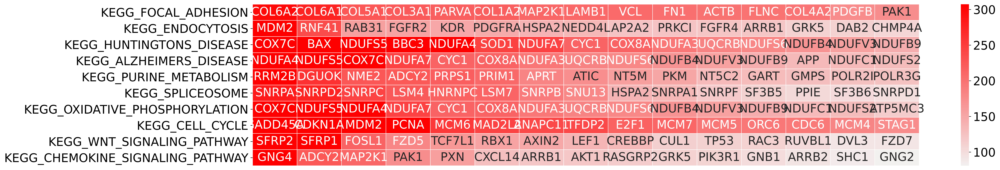

In [65]:
if len(results_table_py) > 0:
    results_table_py = getAnnGenes(results_table_py, GO2gene['kegg_pathways'], rank_copy)
    _, df = plotGenesInTerm(results_table_py, GO2gene['kegg_pathways'], rank_copy, n_top_terms = 10, n_top_genes = 15, cmap = cmap_up)

In [66]:
if len(results_table_py) > 0:
    intTable(df, folder = folder, fileName = 'genesInTerm_KEGG_up.xlsx', save = True)

:::

## Downregulated

In [67]:
%%R -i allDownSelected -i allGenes

allGenes_v <- c(allDownSelected)
#print(allGenes_v)
names(allGenes_v) <- allGenes
allGenes_v <- unlist(allGenes_v)

geneNames <- c(allGenes)

ann_org_BP <- topGO::annFUN.org(whichOnto='BP', feasibleGenes=names(allGenes_v), 
                           mapping='org.Hs.eg', ID='symbol')

ann_org_MF <- topGO::annFUN.org(whichOnto='MF', feasibleGenes=names(allGenes_v), 
                           mapping='org.Hs.eg', ID='symbol')

ann_org_CC <- topGO::annFUN.org(whichOnto='CC', feasibleGenes=names(allGenes_v), 
                           mapping='org.Hs.eg', ID='symbol')

selection <- function(allScores){return (as.logical(allScores))}

::: {.panel-tabset}

### Biological Process

In [68]:
%%R
#print(lapply(ann_org_BP, count_genes))

GOdata <- new("topGOdata",
  ontology="BP",
  allGenes=allGenes_v,
  annot=annFUN.GO2genes,
  GO2genes=ann_org_BP,
  geneSel = selection,
  nodeSize=10)

In [69]:
%%R -o results

results <- runTest(GOdata, algorithm="weight01",statistic="fisher")

In [70]:
scores = ro.r.score(results)
score_names = ro.r(
'''
names(results@score)
'''
)
go_data = ro.r.GOdata

genesData = ro.r(
'''
geneData(results)
'''
)
genesData

array([13071,  1005,    10,  5355], dtype=int32)

In [71]:
#num_summarize = min(100, len(score_names))
results_table = ro.r.GenTable(go_data, weight=results,
        orderBy="weight", topNodes=len(scores))

In [72]:
results_table_py = ro.conversion.rpy2py(results_table)

In [73]:
scores_py = ro.conversion.rpy2py(scores)
score_names = [i for i in score_names]

In [74]:
scores_df = pd.DataFrame({'Scores': scores_py, 'GO.ID': score_names})
results_table_py = results_table_py.merge(scores_df, left_on = 'GO.ID', right_on = 'GO.ID')
results_table_py

,GO.ID,Term,Annotated,Significant,Expected,weight,Scores
0,GO:0030198,extracellular matrix organization,267,85,20.53,1.3e-17,1.266199e-17
1,GO:0045944,positive regulation of transcription by ...,1054,156,81.04,2.1e-17,2.050034e-17
2,GO:0009952,anterior/posterior pattern specification,185,53,14.22,1.4e-14,1.410653e-14
3,GO:0003148,outflow tract septum morphogenesis,24,16,1.85,5.4e-13,5.436684e-13
4,GO:0007155,cell adhesion,1176,214,90.42,3.6e-12,3.612546e-12
...,...,...,...,...,...,...,...
6269,GO:2001032,regulation of double-strand break repair...,28,0,2.15,1.00000,1.000000e+00
6270,GO:2001034,positive regulation of double-strand bre...,15,0,1.15,1.00000,1.000000e+00
6271,GO:2001241,positive regulation of extrinsic apoptot...,10,0,0.77,1.00000,1.000000e+00
6272,GO:2001256,regulation of store-operated calcium ent...,14,0,1.08,1.00000,1.000000e+00


In [75]:
results_table_py = results_table_py[results_table_py['Scores'] < 0.05]
results_table_py = results_table_py[results_table_py['Annotated'] < 200]
results_table_py = results_table_py[results_table_py['Annotated'] > 15]

In [76]:
results_table_py['-log10(pvalue)'] = - np.log10(results_table_py.Scores)
results_table_py['Significant/Annotated'] = results_table_py['Significant'] / results_table_py['Annotated']

In [77]:
intTable(results_table_py, folder = folder, fileName = 'GO_BP_down.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./deg_in_cluster_tables/c..., filename='GO_BP_down.xlsx', label='Download GO_BP_down.xlsx'...)
    [1] Tabulator(page_size=10, pagination='remote', value=          GO.ID  ...)

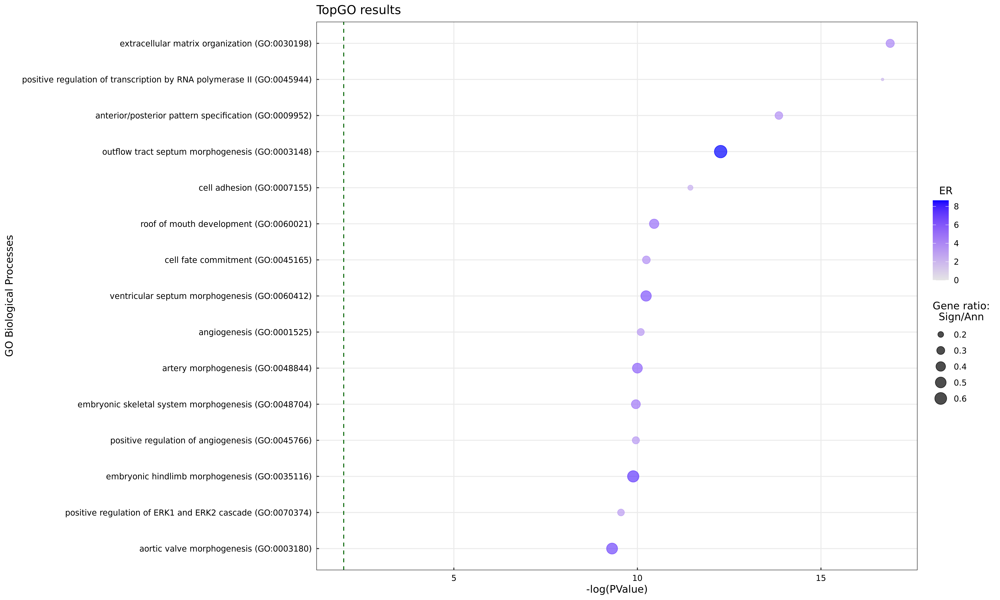

In [78]:
%%R
Res <- GenTable(GOdata, weight=results,
        orderBy="weight", topNodes=length(score(results)))
#print(Res[0:10,])
colnames(Res) <- c("GO.ID", "Term", "Annotated", "Significant", "Expected", "Statistics")
Res$ER <- Res$Significant / Res$Expected
bubbleplot(Res, Ont = 'BP', fillCol = 'blue')

In [79]:
#| echo: False

default_width = 20
default_height = 7
rpy2.ipython.rmagic.RMagics.setup_graphics = new_setup_graphics

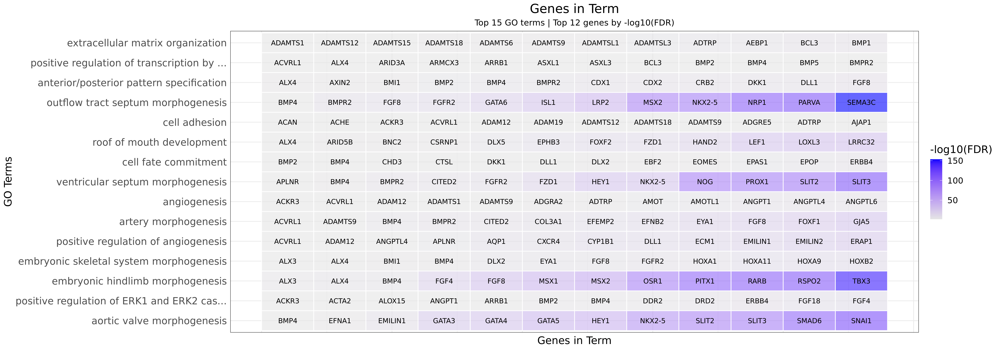

In [80]:
%%R -i markers
plotGenesInTerm_v1(Res, GOdata, SE = markers, nterms=15, ngenes=12,
                             fillCol='blue', log = TRUE)

In [81]:
%%R -i markers -i folder
saveGenesInTerm(Res, GOdata, nterms = 20, path = paste0(folder,'GO_BP_genesInTerm_down.xlsx'), SE = markers)

In [82]:
#| echo: False

default_width = 15
default_height = 9
rpy2.ipython.rmagic.RMagics.setup_graphics = new_setup_graphics

### Molecular Function

In [83]:
%%R

GOdata <- new("topGOdata",
  ontology="MF",
  allGenes=allGenes_v,
  annot=annFUN.GO2genes,
  GO2genes=ann_org_MF,
  geneSel = selection,
  nodeSize=10)

In [84]:
%%R -o results

results <- runTest(GOdata, algorithm="weight01",statistic="fisher")

In [85]:
scores = ro.r.score(results)
score_names = ro.r(
'''
names(results@score)
'''
)
go_data = ro.r.GOdata

genesData = ro.r(
'''
geneData(results)
'''
)
genesData

array([13424,  1024,    10,   886], dtype=int32)

In [86]:
#num_summarize = min(100, len(score_names))
results_table = ro.r.GenTable(go_data, weight=results,
        orderBy="weight", topNodes=len(scores))

In [87]:
results_table_py = ro.conversion.rpy2py(results_table)

In [88]:
scores_py = ro.conversion.rpy2py(scores)
score_names = [i for i in score_names]

In [89]:
scores_df = pd.DataFrame({'Scores': scores_py, 'GO.ID': score_names})
results_table_py = results_table_py.merge(scores_df, left_on = 'GO.ID', right_on = 'GO.ID')
results_table_py = results_table_py[results_table_py['Scores'] < 0.05]
results_table_py = results_table_py[results_table_py['Annotated'] < 200]
results_table_py = results_table_py[results_table_py['Annotated'] > 15]

intTable(results_table_py, folder = folder, fileName = 'GO_MF_down.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./deg_in_cluster_tables/c..., filename='GO_MF_down.xlsx', label='Download GO_MF_down.xlsx'...)
    [1] Tabulator(page_size=10, pagination='remote', value=         GO.ID            ...)

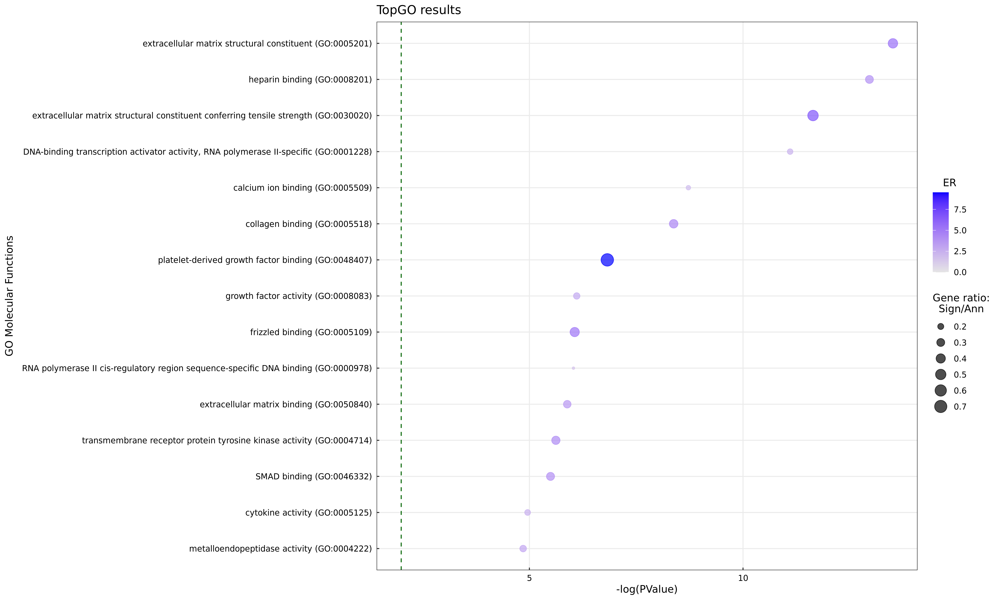

In [90]:
%%R
Res <- GenTable(GOdata, weight=results,
        orderBy="weight", topNodes=length(score(results)))
#print(Res[0:10,])
colnames(Res) <- c("GO.ID", "Term", "Annotated", "Significant", "Expected", "Statistics")
Res$ER <- Res$Significant / Res$Expected
bubbleplot(Res, Ont = 'MF', fillCol = 'blue')

In [91]:
#| echo: False

default_width = 20
default_height = 7
rpy2.ipython.rmagic.RMagics.setup_graphics = new_setup_graphics

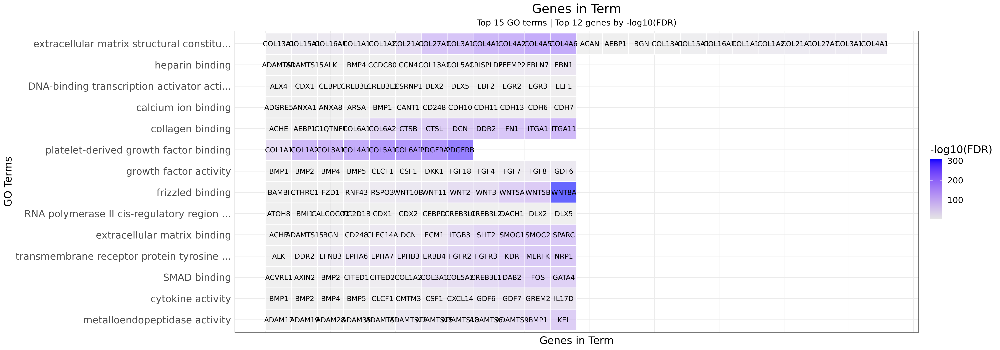

In [92]:
%%R -i markers
plotGenesInTerm_v1(Res, GOdata, SE = markers, nterms=15, ngenes=12,
                             fillCol='blue', log = TRUE)

In [93]:
%%R -i markers -i folder
saveGenesInTerm(Res, GOdata, nterms = 20, path = paste0(folder,'GO_MF_genesInTerm_down.xlsx'), SE = markers)

In [94]:
#| echo: False

default_width = 15
default_height = 9
rpy2.ipython.rmagic.RMagics.setup_graphics = new_setup_graphics

### Cellular Compartment

In [95]:
%%R

GOdata <- new("topGOdata",
  ontology="CC",
  allGenes=allGenes_v,
  annot=annFUN.GO2genes,
  GO2genes=ann_org_CC,
  geneSel = selection,
  nodeSize=10)

In [96]:
%%R -o results

results <- runTest(GOdata, algorithm="weight01",statistic="fisher")

In [97]:
scores = ro.r.score(results)
score_names = ro.r(
'''
names(results@score)
'''
)
go_data = ro.r.GOdata

genesData = ro.r(
'''
geneData(results)
'''
)
genesData

array([13666,  1043,    10,   591], dtype=int32)

In [98]:
#num_summarize = min(100, len(score_names))
results_table = ro.r.GenTable(go_data, weight=results,
        orderBy="weight", topNodes=len(scores))

In [99]:
results_table_py = ro.conversion.rpy2py(results_table)

In [100]:
scores_py = ro.conversion.rpy2py(scores)
score_names = [i for i in score_names]

In [101]:
scores_df = pd.DataFrame({'Scores': scores_py, 'GO.ID': score_names})
results_table_py = results_table_py.merge(scores_df, left_on = 'GO.ID', right_on = 'GO.ID')

In [102]:
results_table_py = results_table_py[results_table_py['Scores'] < 0.05]
results_table_py = results_table_py[results_table_py['Annotated'] < 200]
results_table_py = results_table_py[results_table_py['Annotated'] > 15]

intTable(results_table_py, folder = folder, fileName = 'GO_CC_down.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./deg_in_cluster_tables/c..., filename='GO_CC_down.xlsx', label='Download GO_CC_down.xlsx'...)
    [1] Tabulator(page_size=10, pagination='remote', value=         GO.ID  ...)

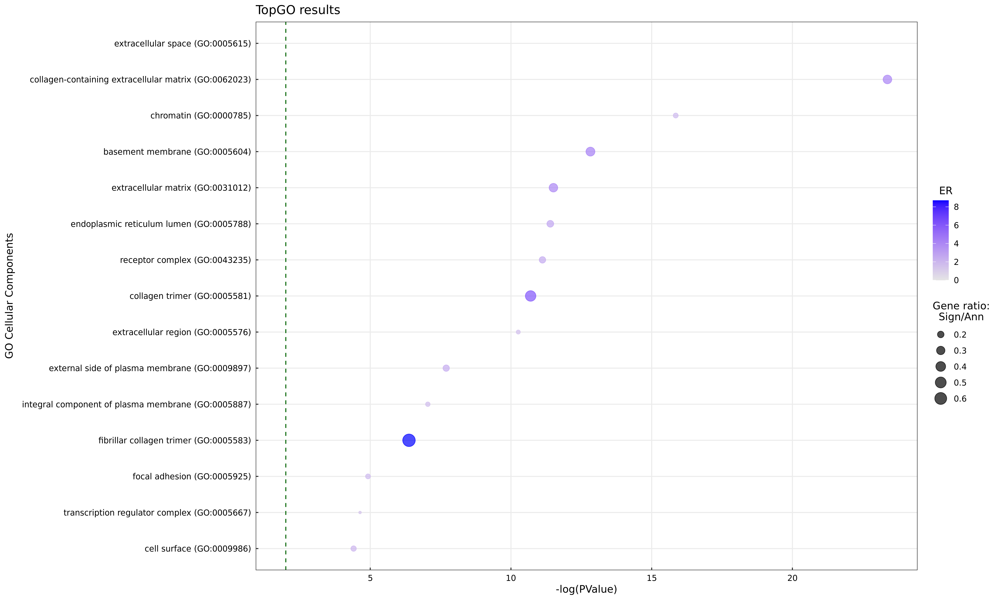

In [103]:
%%R
Res <- GenTable(GOdata, weight=results,
        orderBy="weight", topNodes=length(score(results)))
#print(Res[0:10,])
colnames(Res) <- c("GO.ID", "Term", "Annotated", "Significant", "Expected", "Statistics")
Res$ER <- Res$Significant / Res$Expected
bubbleplot(Res, Ont = 'CC', fillCol = 'blue')

In [104]:
#| echo: False

default_width = 20
default_height = 7
rpy2.ipython.rmagic.RMagics.setup_graphics = new_setup_graphics

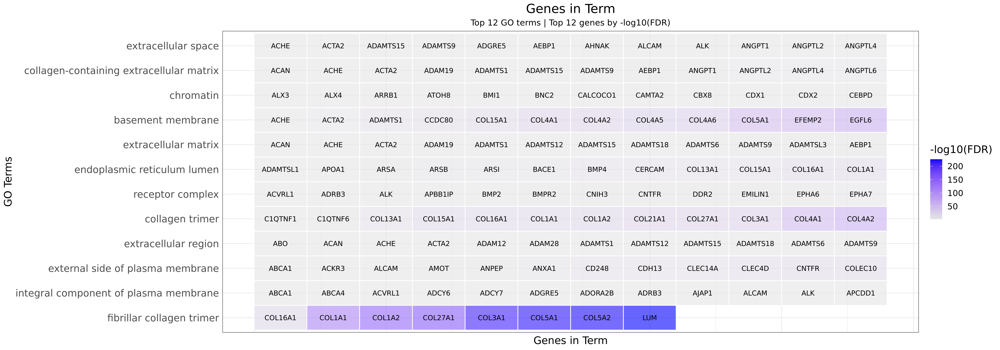

In [105]:
%%R -i markers
plotGenesInTerm_v1(Res, GOdata, SE = markers, nterms=12, ngenes=12,
                             fillCol='blue', log = TRUE)

In [106]:
%%R -i markers -i folder
saveGenesInTerm(Res, GOdata, nterms = 20, path = paste0(folder,'GO_CC_genesInTerm_down.xlsx'), SE = markers)

In [107]:
#| echo: False

default_width = 15
default_height = 9
rpy2.ipython.rmagic.RMagics.setup_graphics = new_setup_graphics

### Pathway annotation

In [108]:
#| echo: False
msigdb = dc.get_resource('MSigDB')

#### Reactome

In [109]:
curated = msigdb[msigdb['collection'].isin(['reactome_pathways'])]
curated = curated[~curated.duplicated(['geneset', 'genesymbol'])]

aggregated = curated[["geneset", "genesymbol"]].groupby("geneset").count().rename(columns={"genesymbol": "gene_count"})
curated = curated[~curated.geneset.isin(aggregated[aggregated.gene_count > 200].index.tolist())].copy()
curated = curated[~curated.geneset.isin(aggregated[aggregated.gene_count < 15].index.tolist())].copy()

In [110]:
rank = pd.DataFrame(markers['-log10(FDR)'])

rank_copy = rank.copy()
rank_copy['pval'] = markers.loc[rank.index].FDR

In [111]:
rank_copy

,-log10(FDR),pval
names,,
CDKN1A,307.381051,0.0
PMAIP1,307.381051,0.0
BBC3,307.381051,0.0
MDM2,307.381051,0.0
GDF15,307.381051,0.0
...,...,...
COL18A1,307.381051,0.0
SERPINB9,307.381051,0.0
RHOB,307.381051,0.0


In [112]:
results_table_py = run_ora_catchErrors(mat=rank.T, net=curated, source='geneset', target='genesymbol', verbose=False, n_up=len(rank), n_bottom=0)
len(results_table_py)

890

In [113]:
intTable(results_table_py, folder = folder, fileName = 'Reactome_down.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./deg_in_cluster_tables/c..., filename='Reactome_down.xlsx', label='Download Reactome_down.xl...)
    [1] Tabulator(page_size=10, pagination='remote', value=              ...)

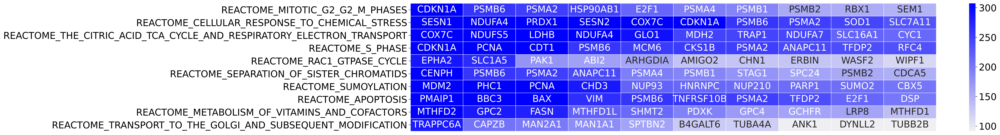

In [114]:
if len(results_table_py) > 0:
    results_table_py = getAnnGenes(results_table_py, GO2gene['reactome_pathways'], rank_copy)
    _, df = plotGenesInTerm(results = results_table_py, GO2gene = GO2gene['reactome_pathways'], DEGs = rank_copy, n_top_terms = 10, cmap = cmap_down)

In [115]:
if len(results_table_py) > 0:
    intTable(df, folder = folder, fileName = 'genesInTerm_Reactome_down.xlsx', save = True)

#### KEGG

In [116]:
curated = msigdb[msigdb['collection'].isin(['kegg_pathways'])]
curated = curated[~curated.duplicated(['geneset', 'genesymbol'])]

aggregated = curated[["geneset", "genesymbol"]].groupby("geneset").count().rename(columns={"genesymbol": "gene_count"})
curated = curated[~curated.geneset.isin(aggregated[aggregated.gene_count > 200].index.tolist())].copy()
curated = curated[~curated.geneset.isin(aggregated[aggregated.gene_count < 15].index.tolist())].copy()

In [117]:
results_table_py = run_ora_catchErrors(mat=rank.T, net=curated, source='geneset', target='genesymbol', verbose=False, n_up=len(rank), n_bottom=0)

In [118]:
intTable(results_table_py, folder = folder, fileName = 'KEGG_down.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./deg_in_cluster_tables/c..., filename='KEGG_down.xlsx', label='Download KEGG_down.xlsx')
    [1] Tabulator(page_size=10, pagination='remote', value=              ...)

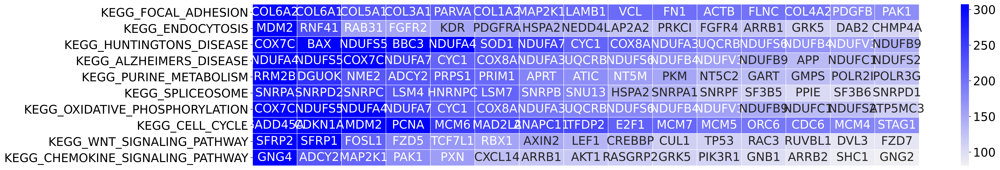

In [119]:
if len(results_table_py) > 0:
    results_table_py = getAnnGenes(results_table_py, GO2gene['kegg_pathways'], rank_copy)
    _, df = plotGenesInTerm(results_table_py, GO2gene['kegg_pathways'], rank_copy, n_top_terms = 10, n_top_genes = 15, cmap = cmap_down)

In [120]:
if len(results_table_py) > 0:
    intTable(df, folder = folder, fileName = 'genesInTerm_KEGG_down.xlsx', save = True)

:::

## All significant

In [121]:
%%R -i allSelected -i allGenes

allGenes_v <- c(allUpSelected)
#print(allGenes_v)
names(allGenes_v) <- allGenes
allGenes_v <- unlist(allGenes_v)

geneNames <- c(allGenes)

ann_org_BP <- topGO::annFUN.org(whichOnto='BP', feasibleGenes=names(allGenes_v), 
                           mapping='org.Hs.eg', ID='symbol')

ann_org_MF <- topGO::annFUN.org(whichOnto='MF', feasibleGenes=names(allGenes_v), 
                           mapping='org.Hs.eg', ID='symbol')

ann_org_CC <- topGO::annFUN.org(whichOnto='CC', feasibleGenes=names(allGenes_v), 
                           mapping='org.Hs.eg', ID='symbol')

selection <- function(allScores){return (as.logical(allScores))}

::: {.panel-tabset}

### Biological Process

In [122]:
%%R
#print(lapply(ann_org_BP, count_genes))

GOdata <- new("topGOdata",
  ontology="BP",
  allGenes=allGenes_v,
  annot=annFUN.GO2genes,
  GO2genes=ann_org_BP,
  geneSel = selection,
  nodeSize=10)

In [123]:
%%R -o results

results <- runTest(GOdata, algorithm="weight01",statistic="fisher")

In [124]:
scores = ro.r.score(results)
score_names = ro.r(
'''
names(results@score)
'''
)
go_data = ro.r.GOdata

genesData = ro.r(
'''
geneData(results)
'''
)
genesData

array([13071,   507,    10,  4522], dtype=int32)

In [125]:
#num_summarize = min(100, len(score_names))
results_table = ro.r.GenTable(go_data, weight=results,
        orderBy="weight", topNodes=len(scores))

In [126]:
results_table_py = ro.conversion.rpy2py(results_table)

In [127]:
scores_py = ro.conversion.rpy2py(scores)
score_names = [i for i in score_names]

In [128]:
scores_df = pd.DataFrame({'Scores': scores_py, 'GO.ID': score_names})
results_table_py = results_table_py.merge(scores_df, left_on = 'GO.ID', right_on = 'GO.ID')
results_table_py

,GO.ID,Term,Annotated,Significant,Expected,weight,Scores
0,GO:0072593,reactive oxygen species metabolic proces...,173,18,6.71,1.2e-05,0.000012
1,GO:0006977,"DNA damage response, signal transduction...",16,6,0.62,1.9e-05,0.000019
2,GO:0042771,intrinsic apoptotic signaling pathway in...,41,9,1.59,0.00038,0.000382
3,GO:0071276,cellular response to cadmium ion,28,6,1.09,0.00060,0.000601
4,GO:0061687,detoxification of inorganic compound,12,4,0.47,0.00086,0.000864
...,...,...,...,...,...,...,...
6269,GO:2001212,regulation of vasculogenesis,15,0,0.58,1.00000,1.000000
6270,GO:2001214,positive regulation of vasculogenesis,11,0,0.43,1.00000,1.000000
6271,GO:2001223,negative regulation of neuron migration,10,0,0.39,1.00000,1.000000
6272,GO:2001224,positive regulation of neuron migration,17,0,0.66,1.00000,1.000000


In [129]:
results_table_py = results_table_py[results_table_py['Scores'] < 0.05]
results_table_py = results_table_py[results_table_py['Annotated'] < 200]
results_table_py = results_table_py[results_table_py['Annotated'] > 15]

In [130]:
results_table_py['-log10(pvalue)'] = - np.log10(results_table_py.Scores)
results_table_py['Significant/Annotated'] = results_table_py['Significant'] / results_table_py['Annotated']

In [131]:
intTable(results_table_py, folder = folder, fileName = 'GO_BP_all.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./deg_in_cluster_tables/c..., filename='GO_BP_all.xlsx', label='Download GO_BP_all.xlsx')
    [1] Tabulator(page_size=10, pagination='remote', value=          GO.ID           ...)

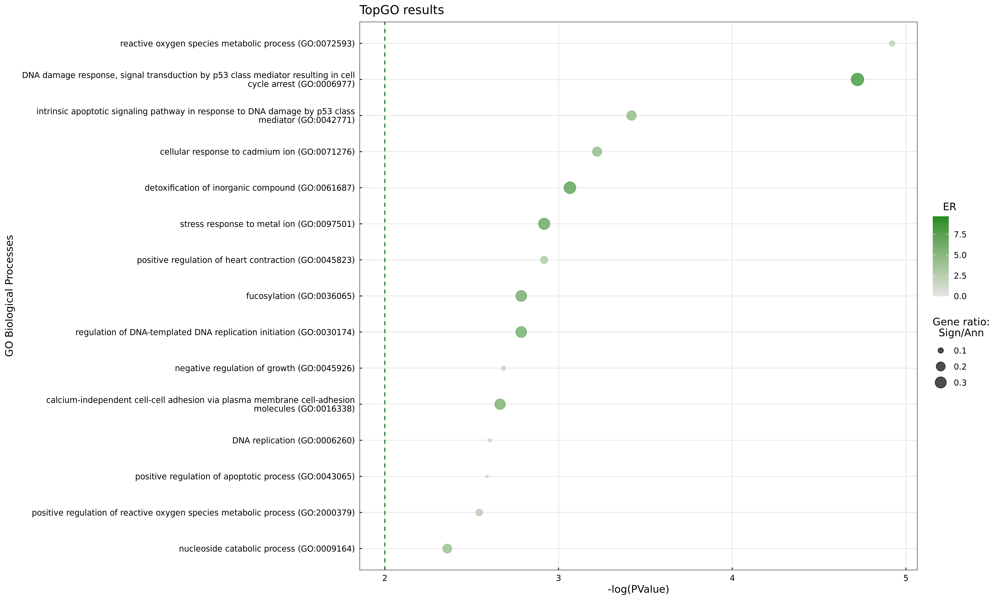

In [132]:
%%R
Res <- GenTable(GOdata, weight=results,
        orderBy="weight", topNodes=length(score(results)))
#print(Res[0:10,])
colnames(Res) <- c("GO.ID", "Term", "Annotated", "Significant", "Expected", "Statistics")
Res$ER <- Res$Significant / Res$Expected
bubbleplot(Res, Ont = 'BP', fillCol = 'forestgreen')

In [133]:
#| echo: False

default_width = 20
default_height = 7
rpy2.ipython.rmagic.RMagics.setup_graphics = new_setup_graphics

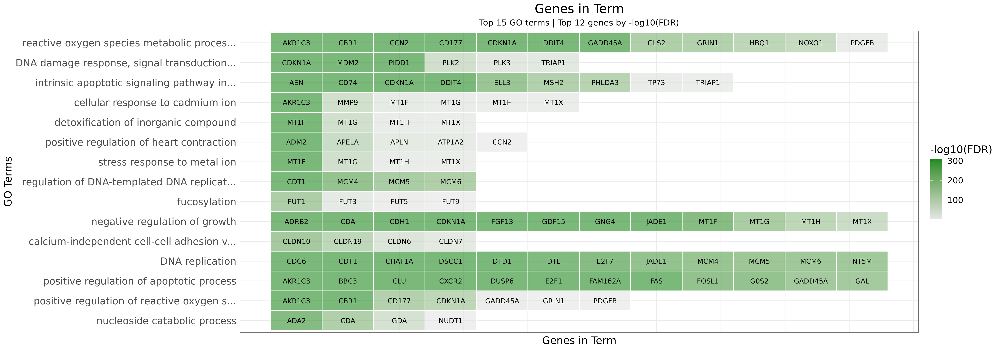

In [134]:
%%R -i markers
plotGenesInTerm_v1(Res, GOdata, SE = markers, nterms=15, ngenes=12,
                             fillCol='forestgreen', log = TRUE)

In [135]:
%%R -i markers -i folder
saveGenesInTerm(Res, GOdata, nterms = 20, path = paste0(folder,'GO_BP_genesInTerm_all.xlsx'), SE = markers)

In [136]:
#| echo: False

default_width = 15
default_height = 9
rpy2.ipython.rmagic.RMagics.setup_graphics = new_setup_graphics

### Molecular Function

In [137]:
%%R

GOdata <- new("topGOdata",
  ontology="MF",
  allGenes=allGenes_v,
  annot=annFUN.GO2genes,
  GO2genes=ann_org_MF,
  geneSel = selection,
  nodeSize=10)

In [138]:
%%R -o results

results <- runTest(GOdata, algorithm="weight01",statistic="fisher")

In [139]:
scores = ro.r.score(results)
score_names = ro.r(
'''
names(results@score)
'''
)
go_data = ro.r.GOdata

genesData = ro.r(
'''
geneData(results)
'''
)
genesData

array([13424,   519,    10,   776], dtype=int32)

In [140]:
#num_summarize = min(100, len(score_names))
results_table = ro.r.GenTable(go_data, weight=results,
        orderBy="weight", topNodes=len(scores))

In [141]:
results_table_py = ro.conversion.rpy2py(results_table)

In [142]:
scores_py = ro.conversion.rpy2py(scores)
score_names = [i for i in score_names]

In [143]:
scores_df = pd.DataFrame({'Scores': scores_py, 'GO.ID': score_names})
results_table_py = results_table_py.merge(scores_df, left_on = 'GO.ID', right_on = 'GO.ID')
results_table_py = results_table_py[results_table_py['Scores'] < 0.05]
results_table_py = results_table_py[results_table_py['Annotated'] < 200]
results_table_py = results_table_py[results_table_py['Annotated'] > 15]

intTable(results_table_py, folder = folder, fileName = 'GO_MF_all.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./deg_in_cluster_tables/c..., filename='GO_MF_all.xlsx', label='Download GO_MF_all.xlsx')
    [1] Tabulator(page_size=10, pagination='remote', value=         GO.ID            ...)

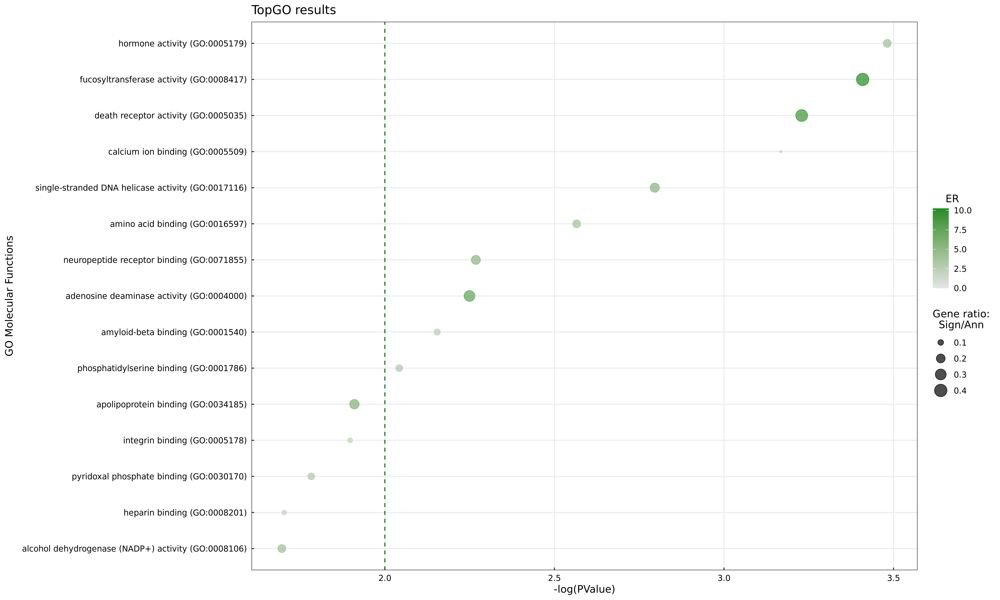

In [144]:
%%R
Res <- GenTable(GOdata, weight=results,
        orderBy="weight", topNodes=length(score(results)))
#print(Res[0:10,])
colnames(Res) <- c("GO.ID", "Term", "Annotated", "Significant", "Expected", "Statistics")
Res$ER <- Res$Significant / Res$Expected
bubbleplot(Res, Ont = 'MF', fillCol = 'forestgreen')

In [145]:
#| echo: False

default_width = 20
default_height = 7
rpy2.ipython.rmagic.RMagics.setup_graphics = new_setup_graphics

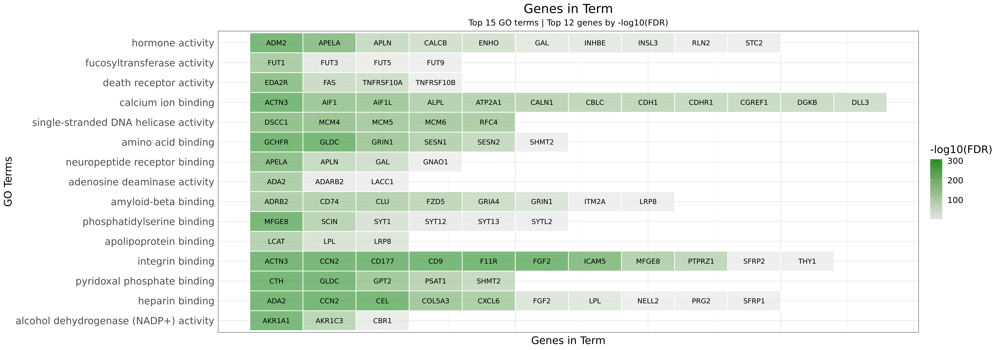

In [146]:
%%R -i markers
plotGenesInTerm_v1(Res, GOdata, SE = markers, nterms=15, ngenes=12,
                             fillCol='forestgreen', log = TRUE)

In [147]:
%%R -i markers -i folder
saveGenesInTerm(Res, GOdata, nterms = 20, path = paste0(folder,'GO_MF_genesInTerm_all.xlsx'), SE = markers)

In [148]:
#| echo: False

default_width = 15
default_height = 9
rpy2.ipython.rmagic.RMagics.setup_graphics = new_setup_graphics

### Cellular Compartment

In [149]:
%%R

GOdata <- new("topGOdata",
  ontology="CC",
  allGenes=allGenes_v,
  annot=annFUN.GO2genes,
  GO2genes=ann_org_CC,
  geneSel = selection,
  nodeSize=10)

In [150]:
%%R -o results

results <- runTest(GOdata, algorithm="weight01",statistic="fisher")

In [151]:
scores = ro.r.score(results)
score_names = ro.r(
'''
names(results@score)
'''
)
go_data = ro.r.GOdata

genesData = ro.r(
'''
geneData(results)
'''
)
genesData

array([13666,   536,    10,   547], dtype=int32)

In [152]:
#num_summarize = min(100, len(score_names))
results_table = ro.r.GenTable(go_data, weight=results,
        orderBy="weight", topNodes=len(scores))

In [153]:
results_table_py = ro.conversion.rpy2py(results_table)

In [154]:
scores_py = ro.conversion.rpy2py(scores)
score_names = [i for i in score_names]

In [155]:
scores_df = pd.DataFrame({'Scores': scores_py, 'GO.ID': score_names})
results_table_py = results_table_py.merge(scores_df, left_on = 'GO.ID', right_on = 'GO.ID')

In [156]:
results_table_py = results_table_py[results_table_py['Scores'] < 0.05]
results_table_py = results_table_py[results_table_py['Annotated'] < 200]
results_table_py = results_table_py[results_table_py['Annotated'] > 15]

intTable(results_table_py, folder = folder, fileName = 'GO_CC_all.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./deg_in_cluster_tables/c..., filename='GO_CC_all.xlsx', label='Download GO_CC_all.xlsx')
    [1] Tabulator(page_size=10, pagination='remote', value=         GO.ID  ...)

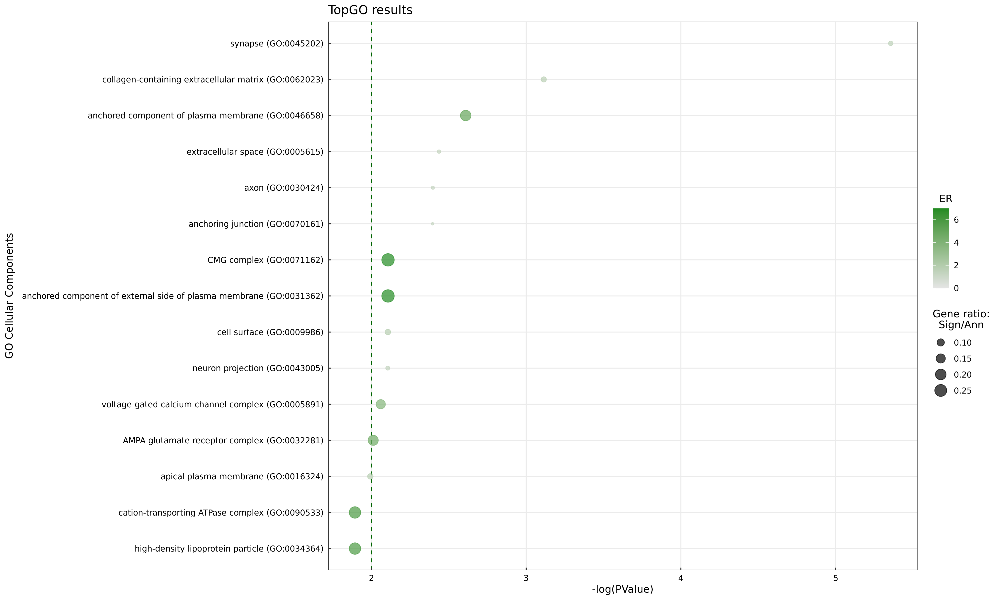

In [157]:
%%R
Res <- GenTable(GOdata, weight=results,
        orderBy="weight", topNodes=length(score(results)))
#print(Res[0:10,])
colnames(Res) <- c("GO.ID", "Term", "Annotated", "Significant", "Expected", "Statistics")
Res$ER <- Res$Significant / Res$Expected
bubbleplot(Res, Ont = 'CC', fillCol = 'forestgreen')

In [158]:
#| echo: False

default_width = 20
default_height = 7
rpy2.ipython.rmagic.RMagics.setup_graphics = new_setup_graphics

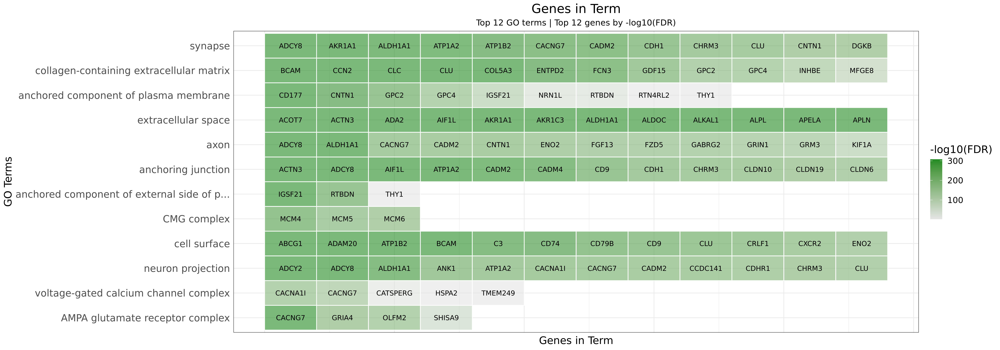

In [159]:
%%R -i markers
plotGenesInTerm_v1(Res, GOdata, SE = markers, nterms=12, ngenes=12,
                             fillCol='forestgreen', log = TRUE)

In [160]:
%%R -i markers -i folder
saveGenesInTerm(Res, GOdata, nterms = 20, path = paste0(folder,'GO_CC_genesInTerm_all.xlsx'), SE = markers)

In [161]:
#| echo: False

default_width = 15
default_height = 9
rpy2.ipython.rmagic.RMagics.setup_graphics = new_setup_graphics

### Pathway annotation

In [162]:
#| echo: False
msigdb = dc.get_resource('MSigDB')

#### Reactome

In [163]:
curated = msigdb[msigdb['collection'].isin(['reactome_pathways'])]
curated = curated[~curated.duplicated(['geneset', 'genesymbol'])]

aggregated = curated[["geneset", "genesymbol"]].groupby("geneset").count().rename(columns={"genesymbol": "gene_count"})
curated = curated[~curated.geneset.isin(aggregated[aggregated.gene_count > 200].index.tolist())].copy()
curated = curated[~curated.geneset.isin(aggregated[aggregated.gene_count < 15].index.tolist())].copy()

In [164]:
rank = pd.DataFrame(markers['-log10(FDR)'])

rank_copy = rank.copy()
rank_copy['pval'] = markers.loc[rank.index].FDR

In [165]:
rank_copy

,-log10(FDR),pval
names,,
CDKN1A,307.381051,0.0
PMAIP1,307.381051,0.0
BBC3,307.381051,0.0
MDM2,307.381051,0.0
GDF15,307.381051,0.0
...,...,...
COL18A1,307.381051,0.0
SERPINB9,307.381051,0.0
RHOB,307.381051,0.0


In [166]:
results_table_py = run_ora_catchErrors(mat=rank.T, net=curated, source='geneset', target='genesymbol', verbose=False, n_up=len(rank), n_bottom=0)
len(results_table_py)

890

In [167]:
intTable(results_table_py, folder = folder, fileName = 'Reactome_all.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./deg_in_cluster_tables/c..., filename='Reactome_all.xlsx', label='Download Reactome_all.xls...)
    [1] Tabulator(page_size=10, pagination='remote', value=              ...)

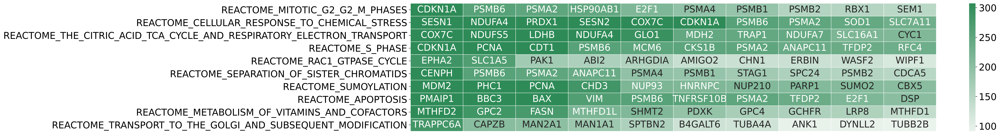

In [168]:
if len(results_table_py) > 0:
    results_table_py = getAnnGenes(results_table_py, GO2gene['reactome_pathways'], rank_copy)
    _, df = plotGenesInTerm(results = results_table_py, GO2gene = GO2gene['reactome_pathways'], DEGs = rank_copy, n_top_terms = 10, cmap = cmap_all)

In [169]:
if len(results_table_py) > 0:
    intTable(df, folder = folder, fileName = 'genesInTerm_Reactome_all.xlsx', save = True)

#### KEGG

In [170]:
curated = msigdb[msigdb['collection'].isin(['kegg_pathways'])]
curated = curated[~curated.duplicated(['geneset', 'genesymbol'])]

aggregated = curated[["geneset", "genesymbol"]].groupby("geneset").count().rename(columns={"genesymbol": "gene_count"})
curated = curated[~curated.geneset.isin(aggregated[aggregated.gene_count > 200].index.tolist())].copy()
curated = curated[~curated.geneset.isin(aggregated[aggregated.gene_count < 15].index.tolist())].copy()

In [171]:
results_table_py = run_ora_catchErrors(mat=rank.T, net=curated, source='geneset', target='genesymbol', verbose=False, n_up=len(rank), n_bottom=0)

In [172]:
intTable(results_table_py, folder = folder, fileName = 'KEGG_all.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./deg_in_cluster_tables/c..., filename='KEGG_all.xlsx', label='Download KEGG_all.xlsx')
    [1] Tabulator(page_size=10, pagination='remote', value=              ...)

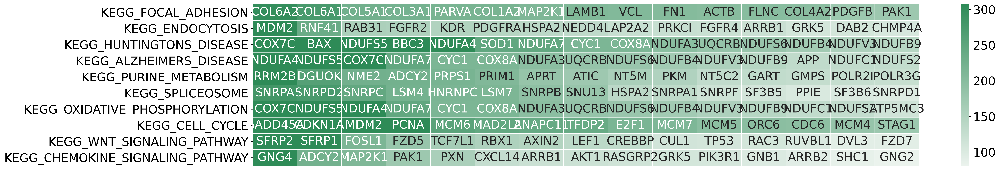

In [173]:
if len(results_table_py) > 0:
    results_table_py = getAnnGenes(results_table_py, GO2gene['kegg_pathways'], rank_copy)
    _, df = plotGenesInTerm(results_table_py, GO2gene['kegg_pathways'], rank_copy, n_top_terms = 10, n_top_genes = 15, cmap = cmap_all)

In [174]:
if len(results_table_py) > 0:
    intTable(df, folder = folder, fileName = 'genesInTerm_KEGG_all.xlsx', save = True)

:::